In [ ]:
!pip install pytorch_lightning --upgrade

In [1]:
# import os
from shutil import copyfile
dp = 'qweasdrf'
# copyfile(src=f'../input/{dp}/getlr.py', dst='../working/getlr.py')
# copyfile(src=f'../input/{dp}/learning_rates.txt', dst='../working/learning_rates.txt')
copyfile(src=f'../input/{dp}/config.py', dst='../working/config.py')
# copyfile(src=f'../input/{dp}/dataset.py', dst='../working/dataset.py')
# copyfile(src=f'../input/{dp}/loss.py', dst='../working/loss.py')
# copyfile(src=f'../input/{dp}/model.py', dst='../working/model.py')
# copyfile(src=f'../input/{dp}/train.py', dst='../working/train.py')
# copyfile(src=f'../input/{dp}/utils.py', dst='../working/utils.py')

'../working/config.py'

In [2]:
# imports
import os

import torch
from pytorch_lightning import LightningModule, Trainer
from torch import nn
from torch.nn import functional as F
from torch.utils.data import DataLoader, random_split
from torchmetrics import Accuracy
from torchvision import transforms

import config
import torch.optim as optim

from model import YOLOv3
from tqdm import tqdm
from utils import (
    mean_average_precision,
    cells_to_bboxes,
    get_evaluation_bboxes,
    save_checkpoint,
    load_checkpoint,
    check_class_accuracy,
    get_loaders,
    plot_couple_examples
)
from loss import YoloLoss
from pytorch_lightning.callbacks import ModelSummary
from pytorch_lightning import LightningModule, Trainer
import warnings
warnings.filterwarnings("ignore")

torch.backends.cudnn.benchmark = True

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6StatusC1EN10tensorflow5error4CodeESt17basic_string_viewIcSt11char_traitsIcEENS_14SourceLocationE']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:104: UserWarning: file system plugins are not loaded: unable to open file: l

In [3]:
from pytorch_lightning.callbacks import ModelSummary


yolo_model = YOLOv3(num_classes=config.NUM_CLASSES).to(config.DEVICE)
# yolo_model = YOLOv3(num_classes=config.NUM_CLASSES)
# init Dataloader from MNIST Dataloader
# train_ds = CIFAR10(PATH_DATASETS, train=True, download=True, transform= transforms.ToTensor())
# train_loader = DataLoader(train_ds, batch_size=BATCH_SIZE)

# initialize the trainer
trainer = Trainer(
    callbacks=[ModelSummary(max_depth=-1)],
    precision = 16,
    devices=1,
    accelerator="gpu",
    max_epochs = 40
)



Training: 0it [00:00, ?it/s]

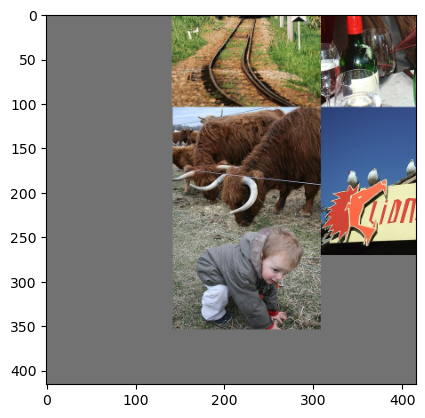

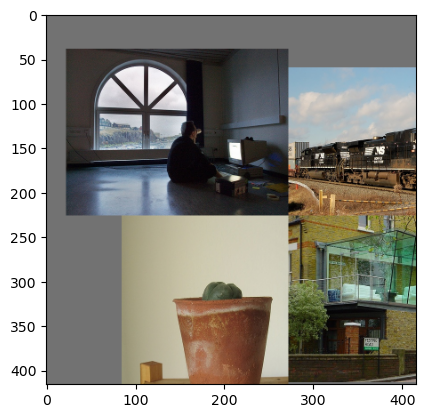

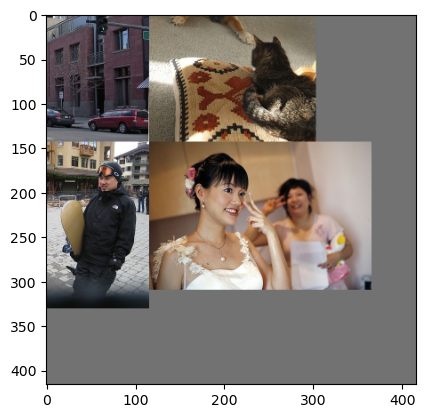

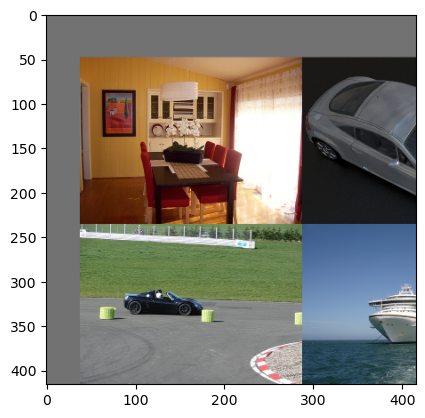

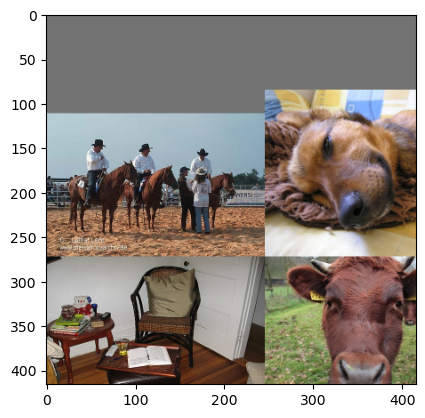

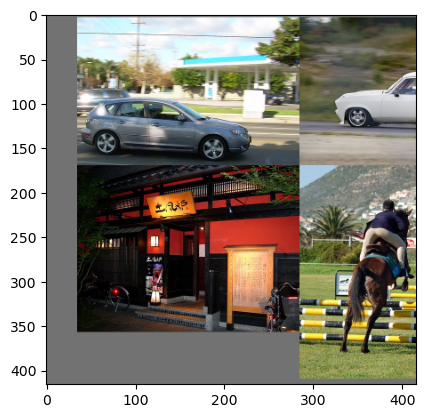

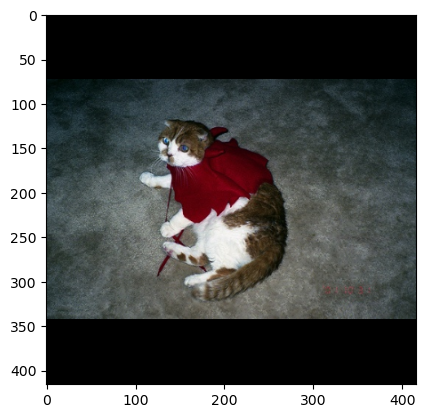

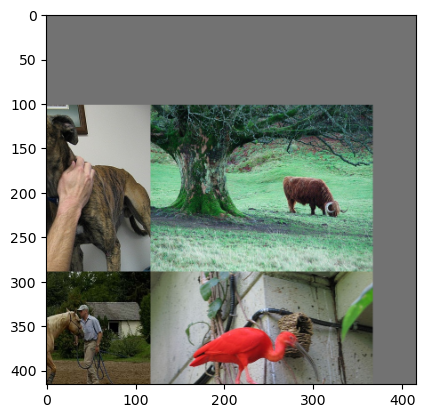

lr:  0.00010434825743724696
loss: 18.4342093614998
Currently epoch 1


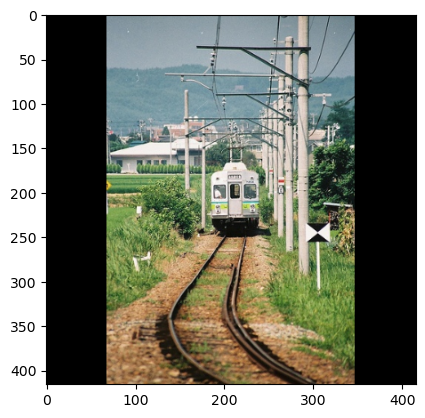

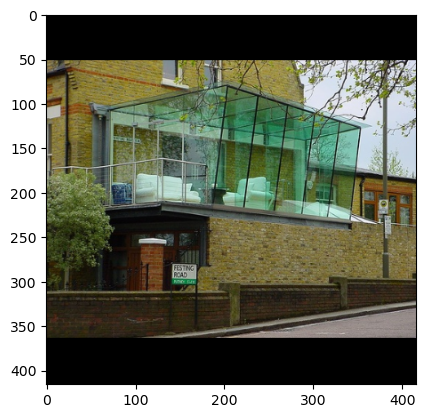

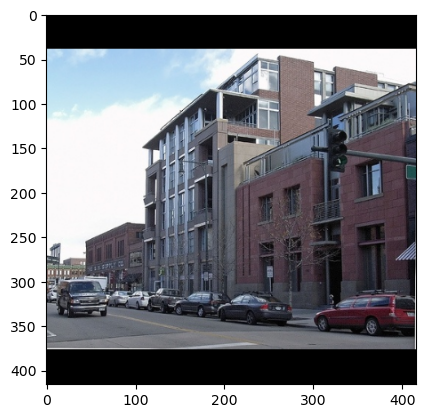

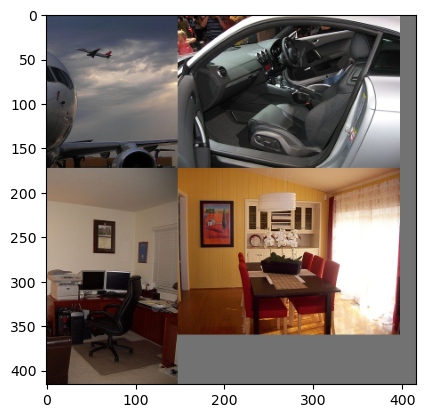

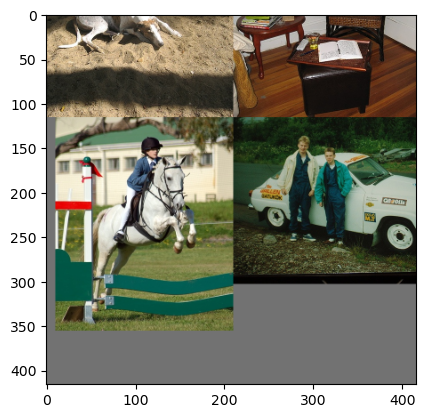

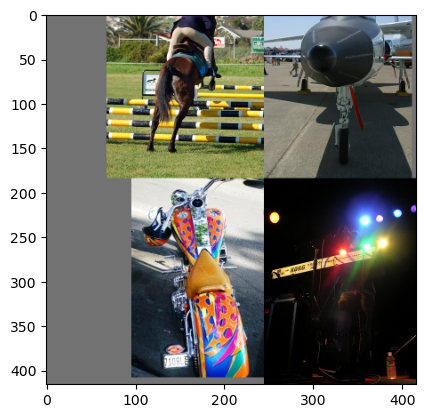

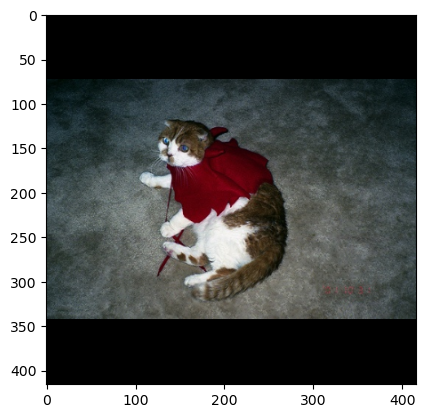

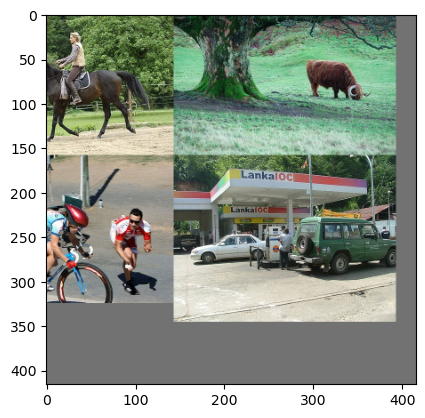

lr:  0.000280140120435612
loss: 12.754320004731992
Currently epoch 2


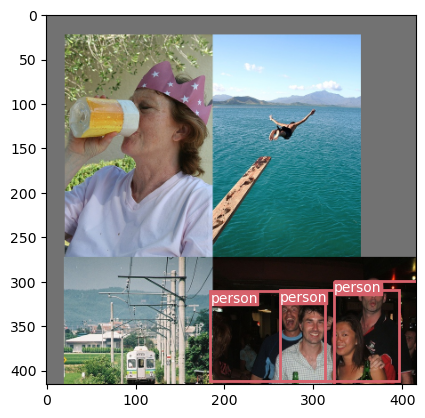

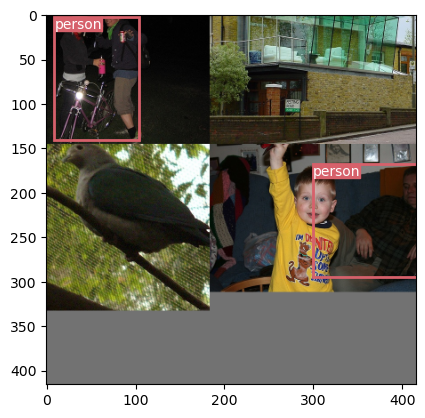

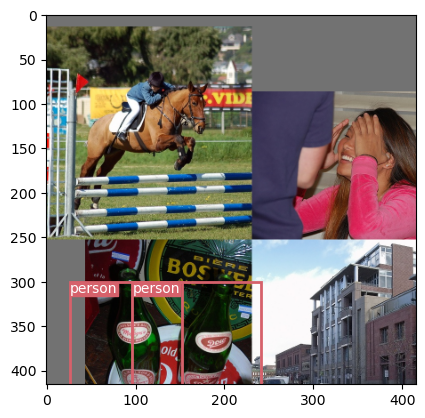

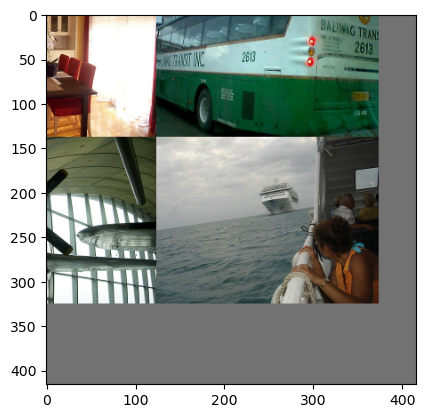

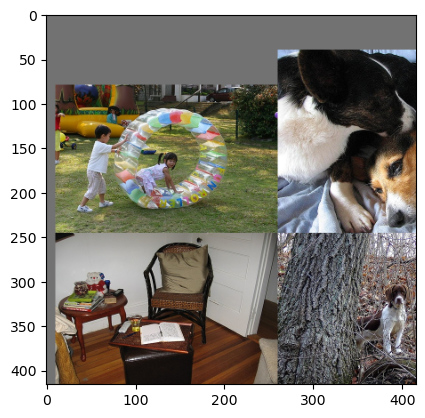

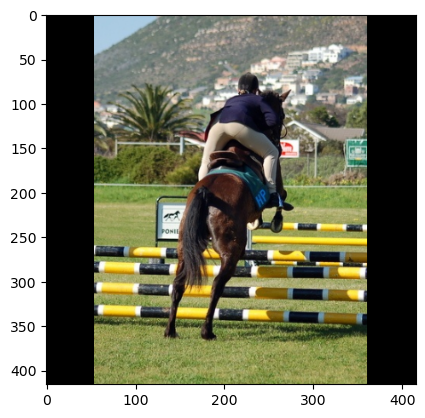

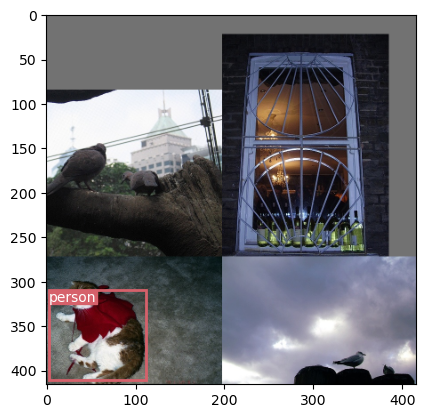

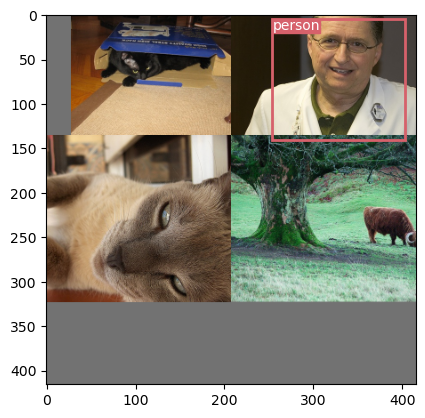

lr:  0.0005202426720967951
loss: 11.511177442248723
Currently epoch 3
On Train loader:



100%|██████████| 518/518 [09:06<00:00,  1.06s/it]


Class accuracy is: 35.718735%
No obj accuracy is: 98.638329%
Obj accuracy is: 19.116505%


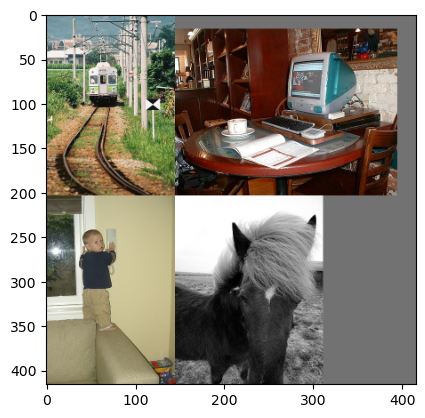

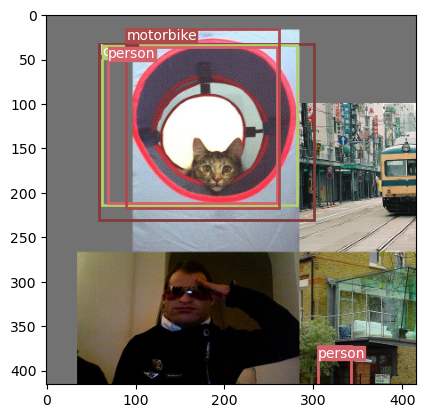

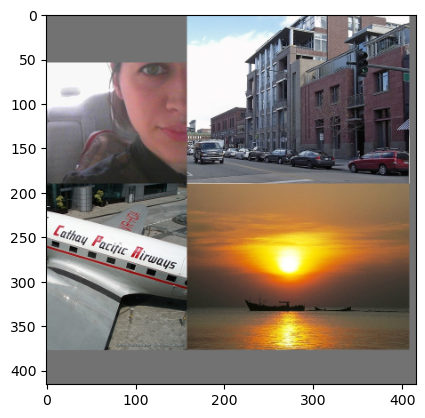

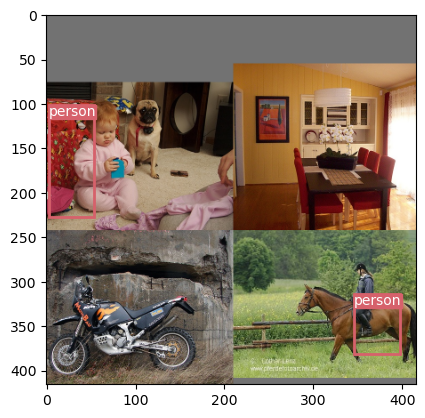

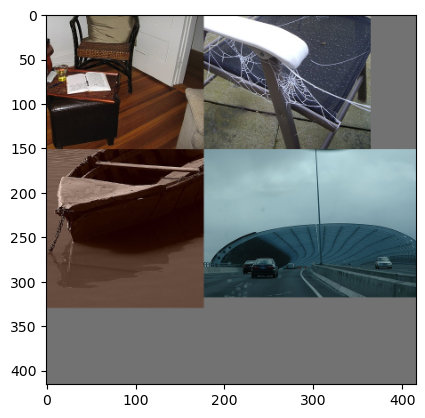

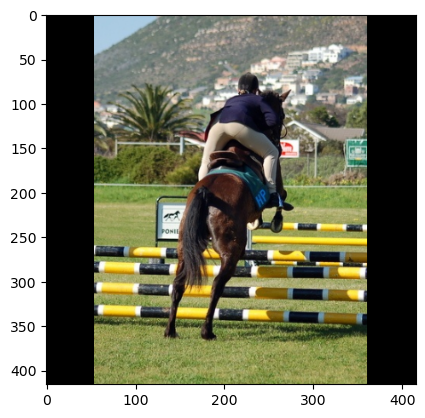

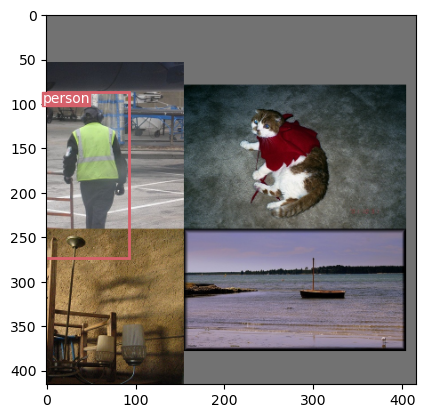

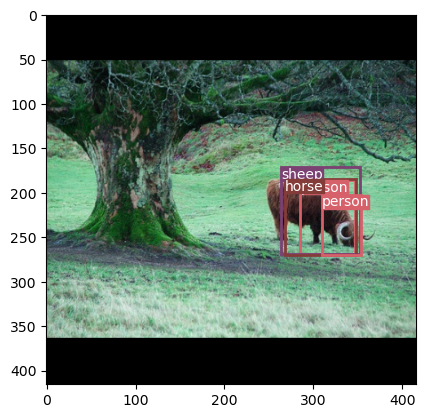

lr:  0.0007602801590639888
loss: 10.823079646784366
Currently epoch 4


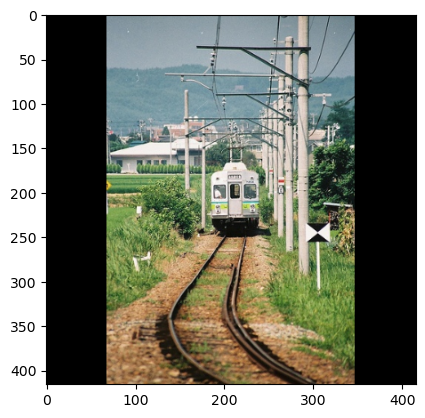

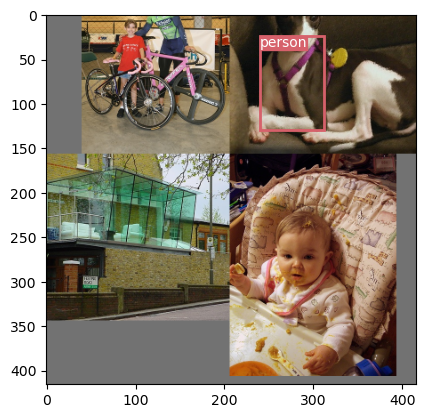

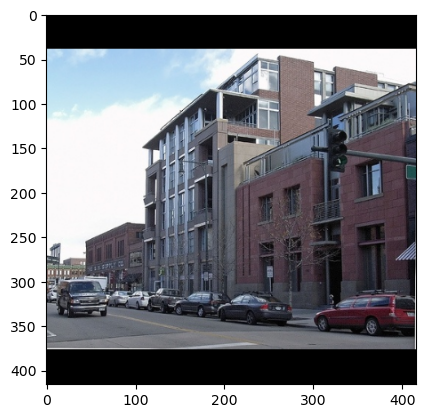

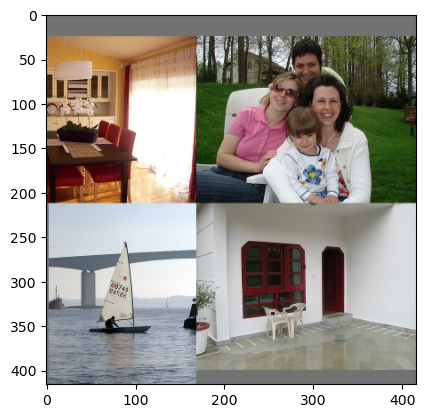

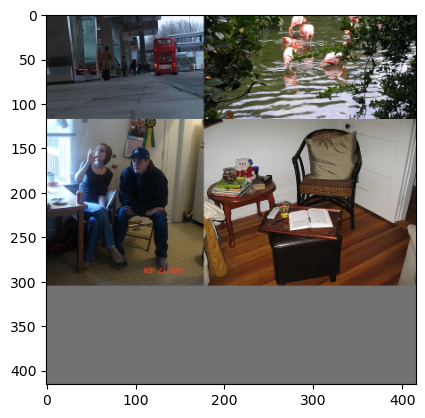

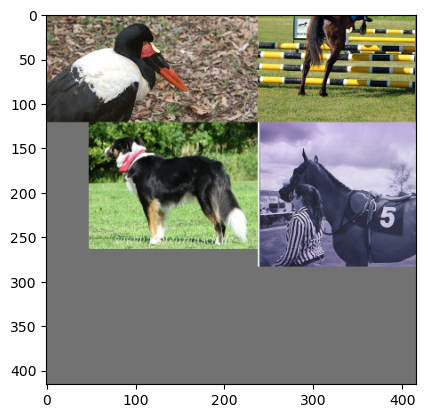

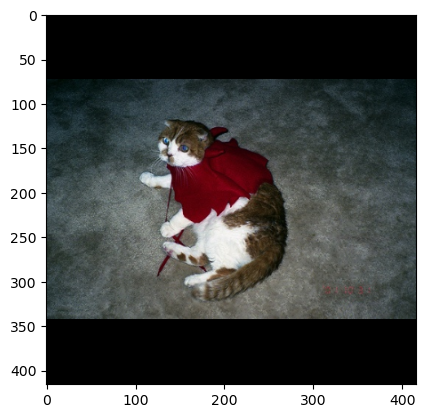

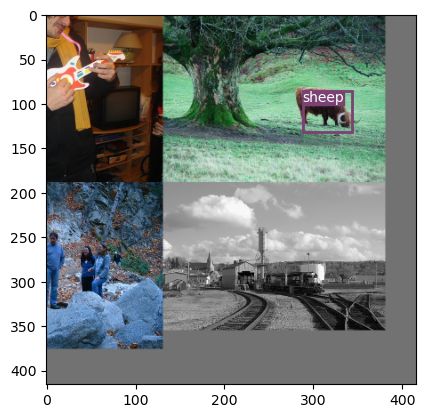

lr:  0.0009358942729790484
loss: 12.671855987268986
Currently epoch 5


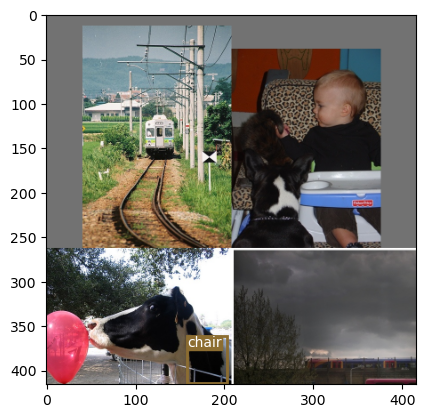

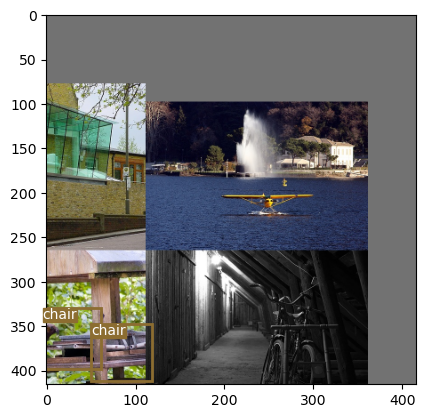

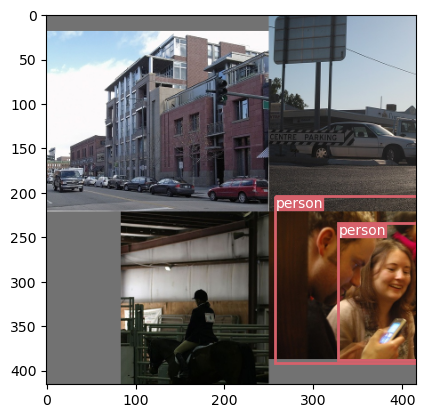

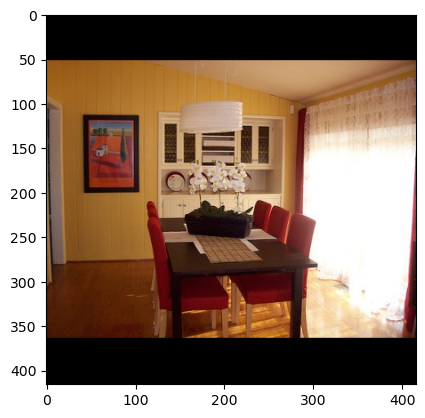

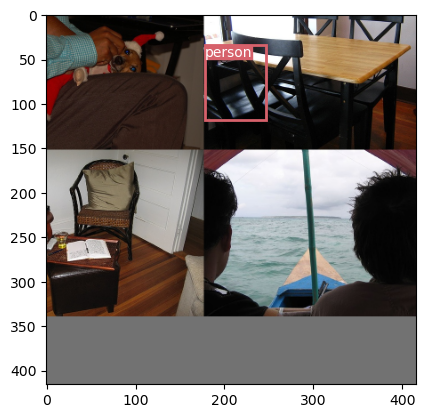

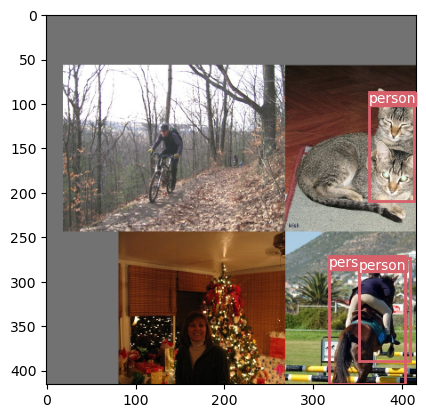

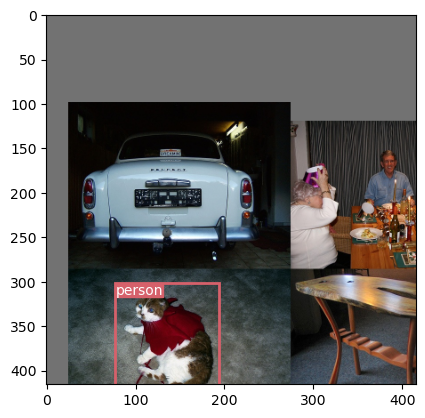

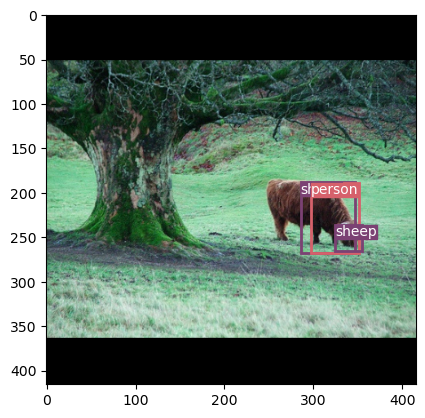

lr:  0.0009999999530838442
loss: 11.087611791249868
Currently epoch 6


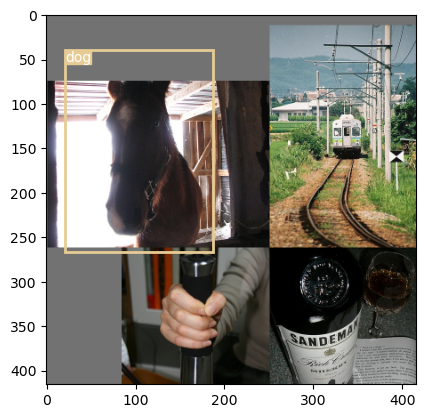

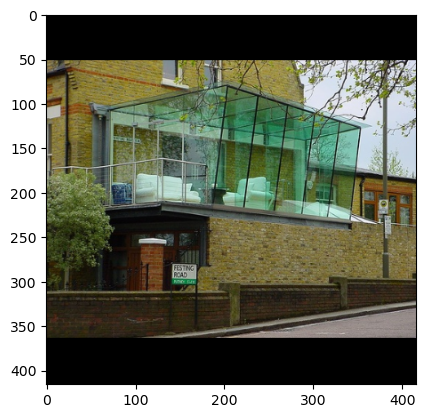

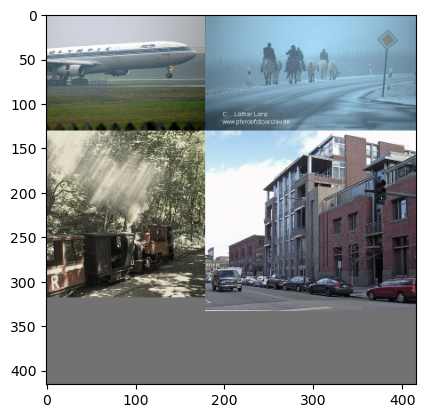

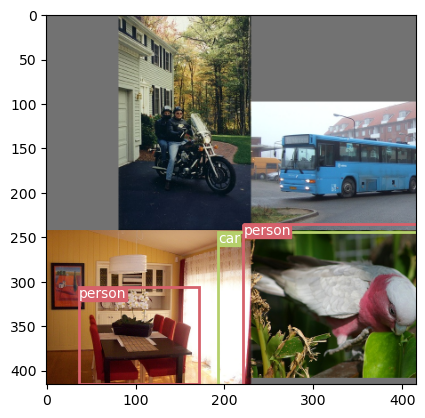

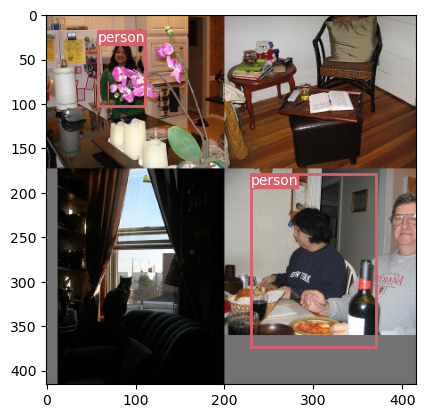

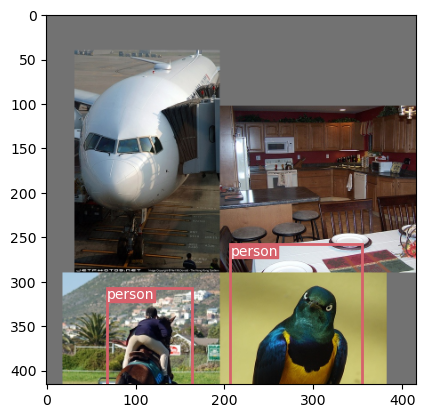

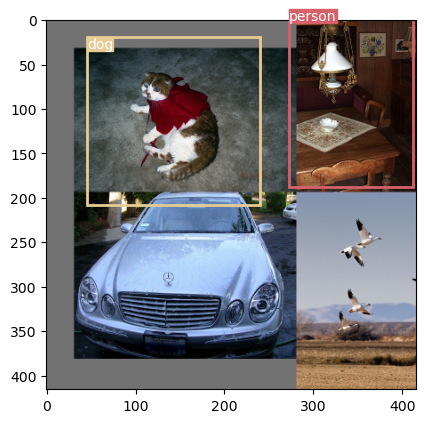

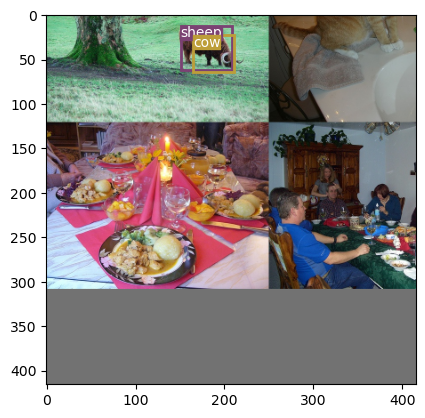

lr:  0.0009874157622524404
loss: 10.241823706387553
Currently epoch 7


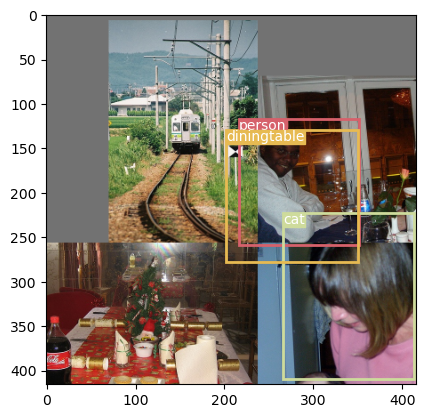

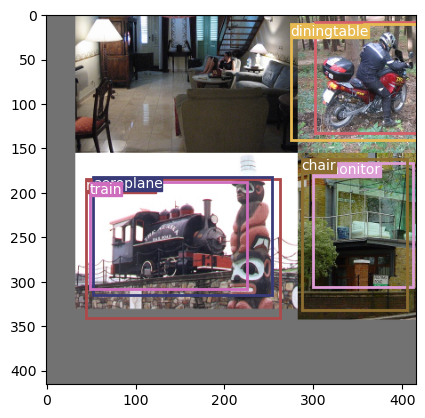

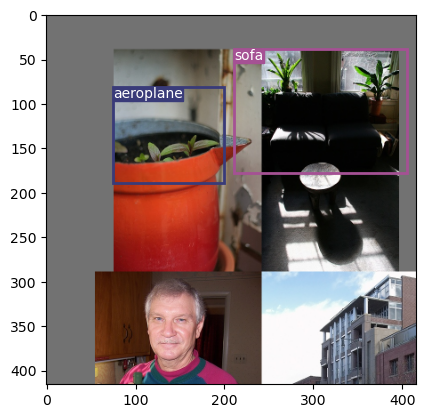

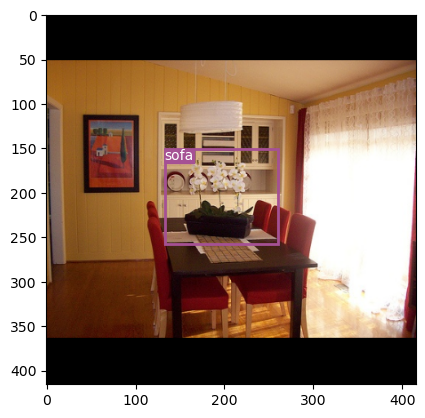

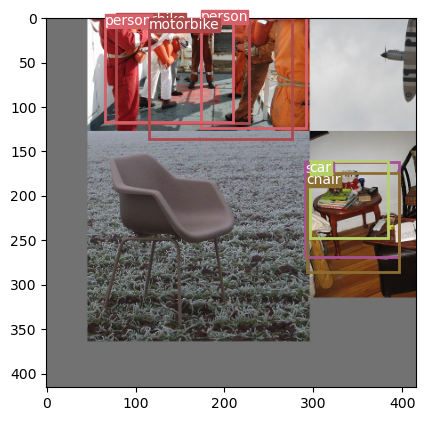

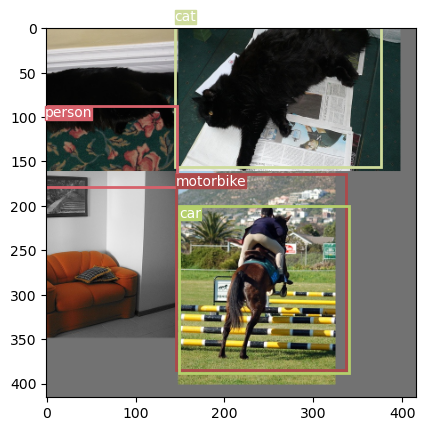

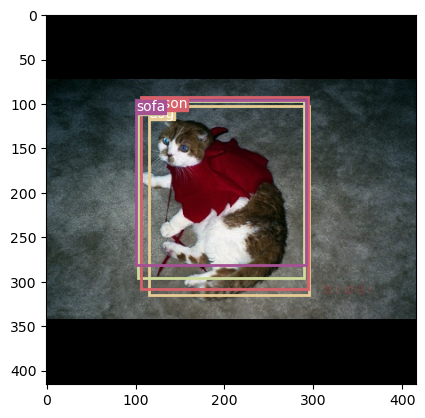

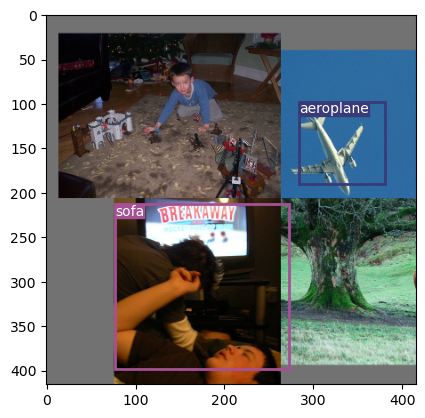

lr:  0.0009503906101190746
loss: 9.65943499605628
Currently epoch 8
On Train loader:



100%|██████████| 518/518 [09:32<00:00,  1.11s/it]


Class accuracy is: 43.343082%
No obj accuracy is: 96.185570%
Obj accuracy is: 51.060986%


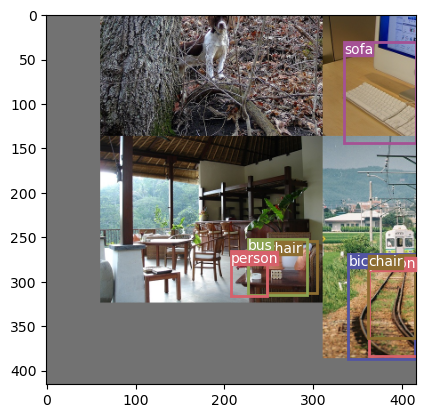

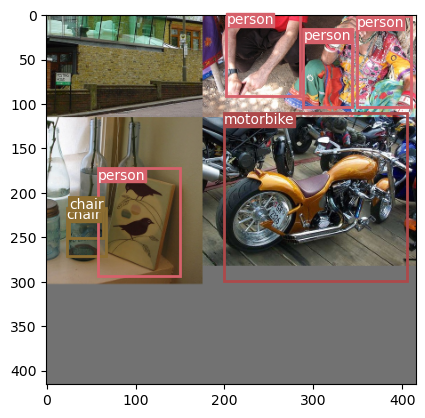

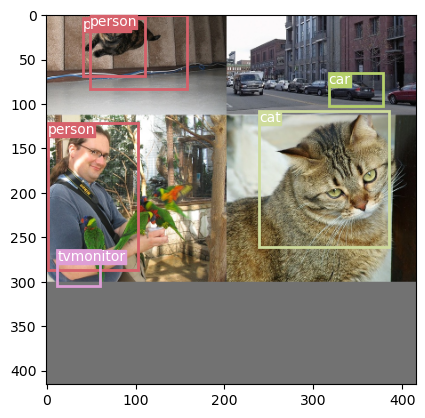

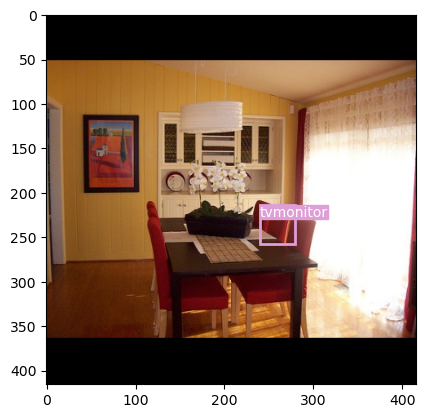

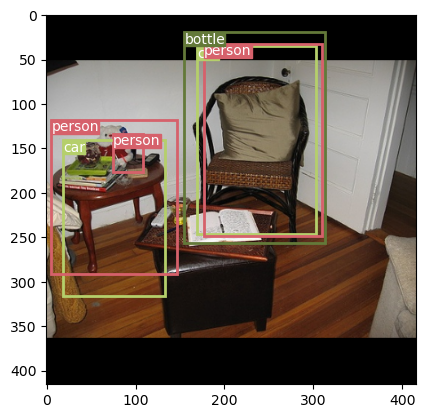

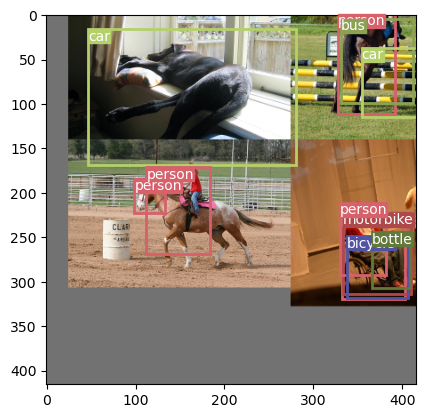

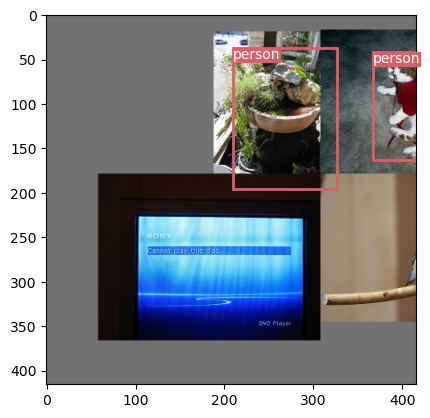

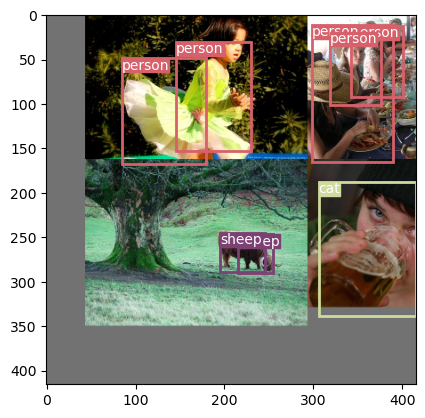

lr:  0.0008907810924152852
loss: 9.212417876858508
Currently epoch 9


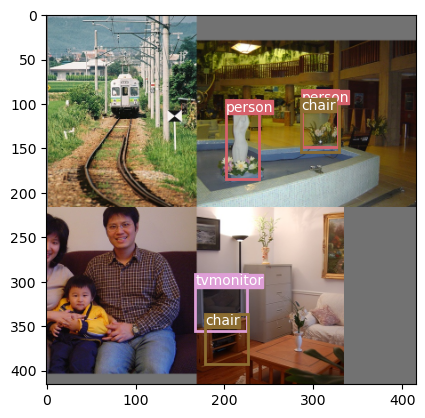

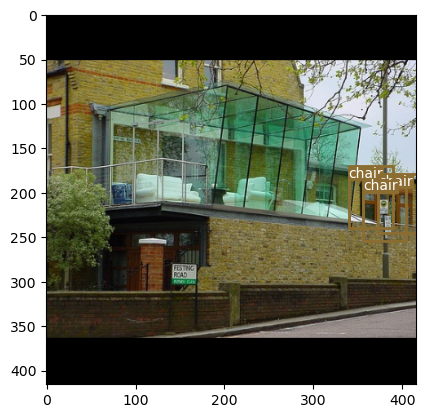

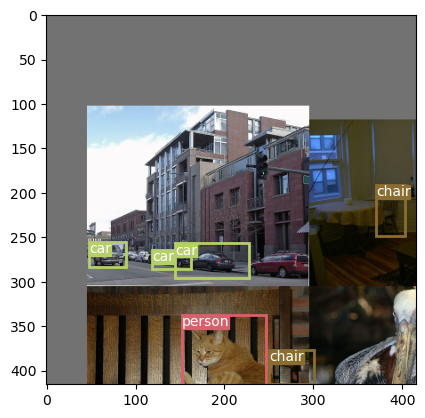

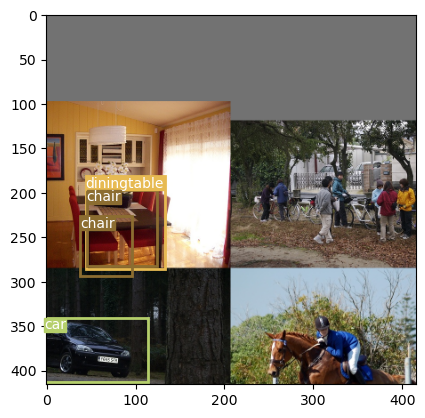

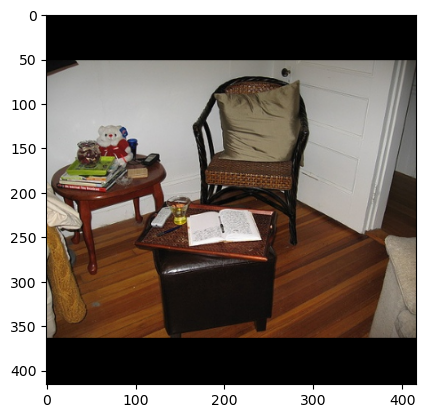

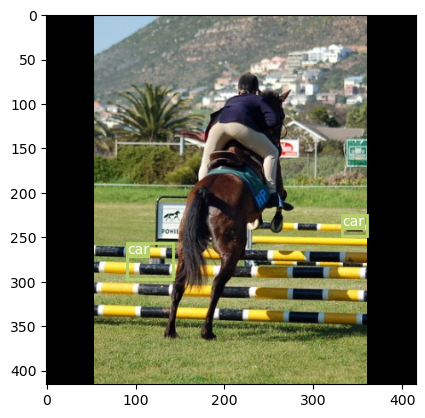

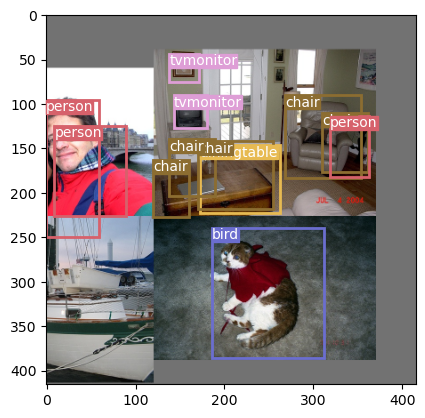

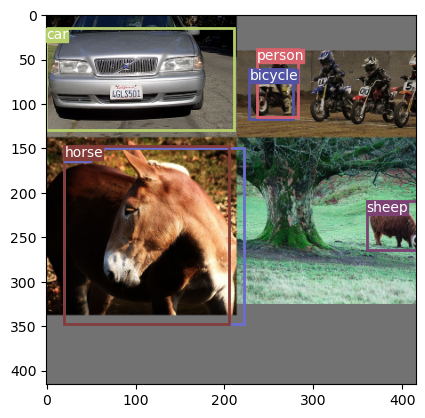

lr:  0.0008115762792664092
loss: 8.972509761574646
Currently epoch 10


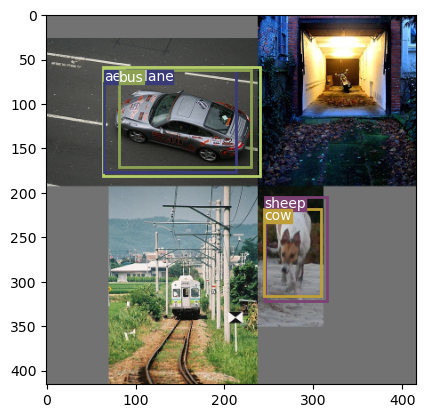

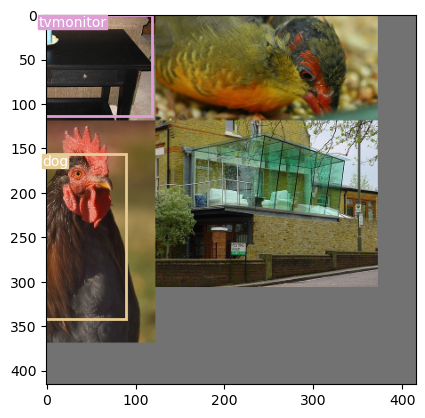

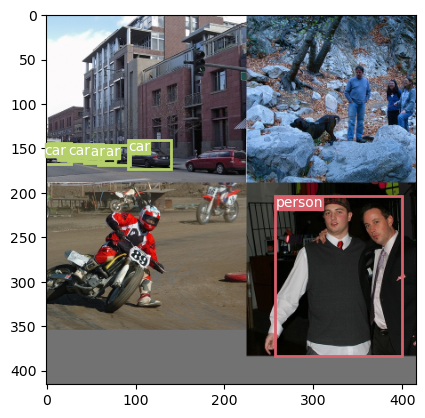

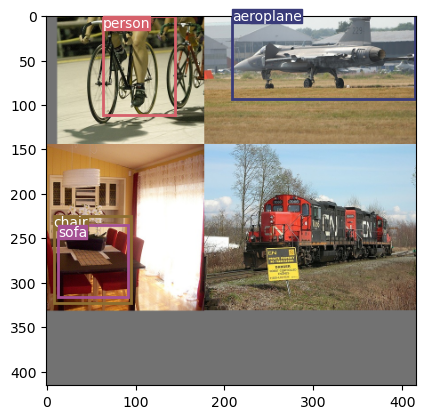

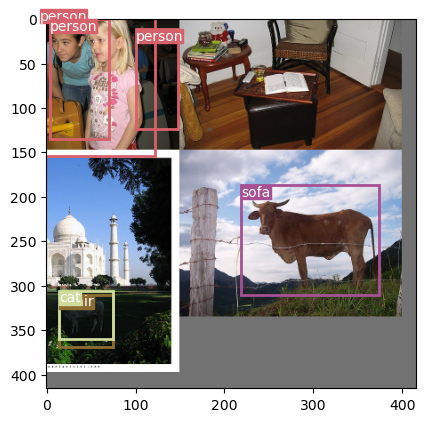

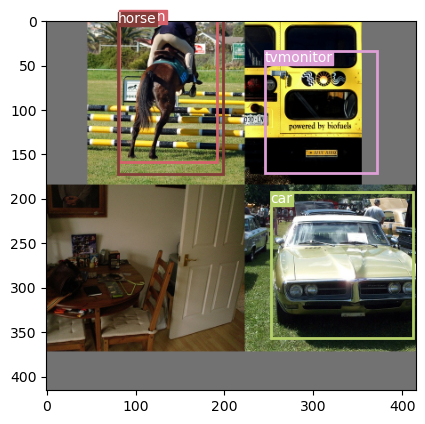

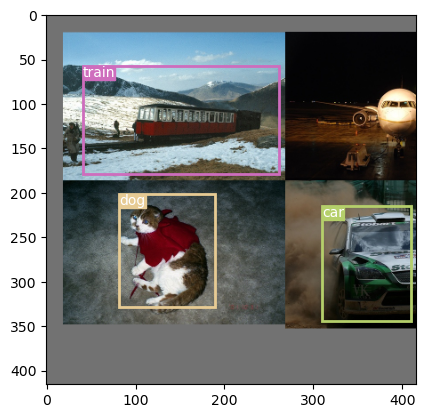

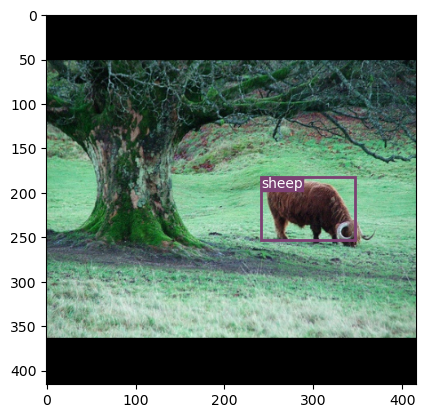

lr:  0.0007167478307342284
=> Saving checkpoint
loss: 8.46728769508568
Currently epoch 11


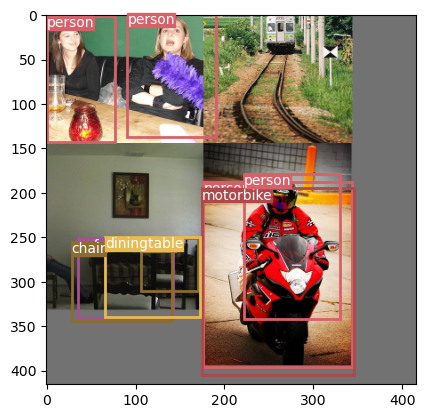

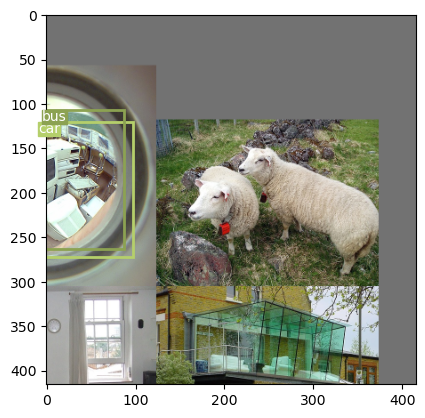

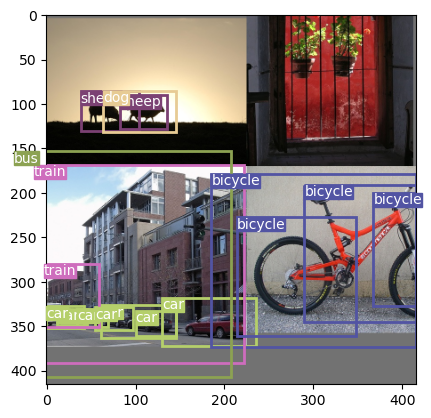

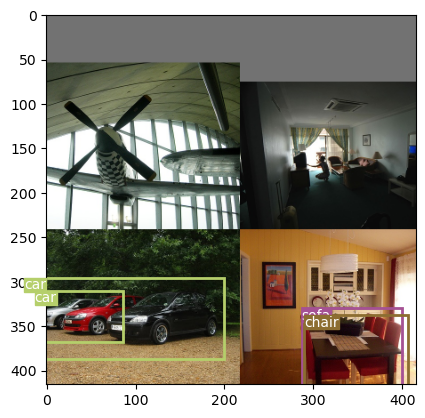

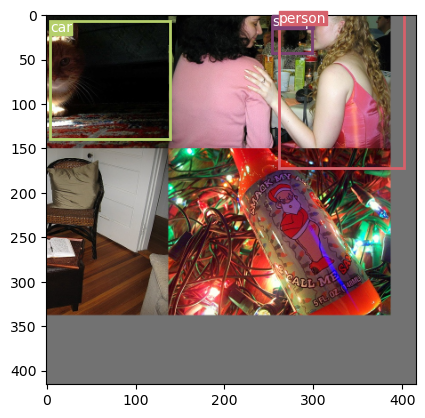

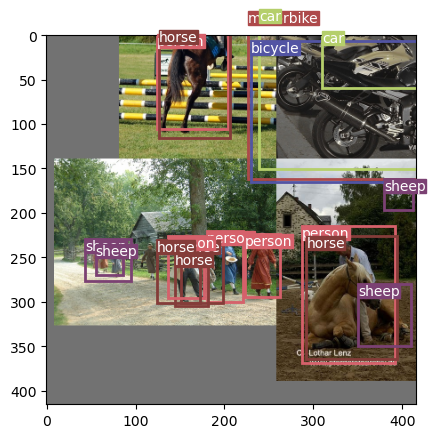

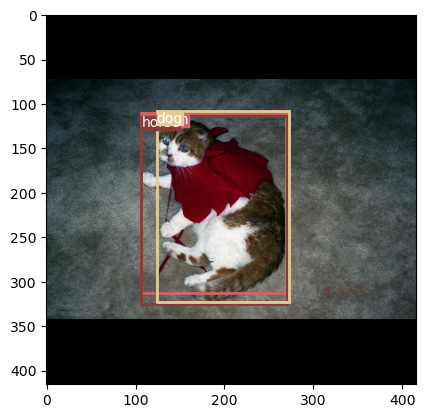

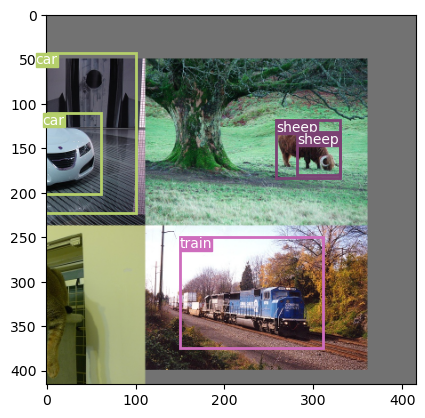

lr:  0.0006110508411972631
loss: 8.057780275933991
Currently epoch 12


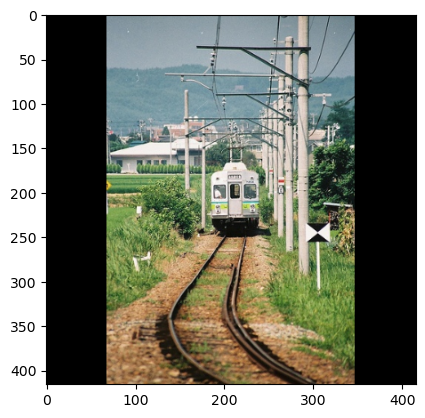

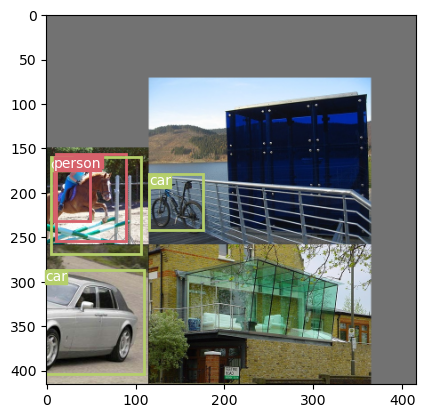

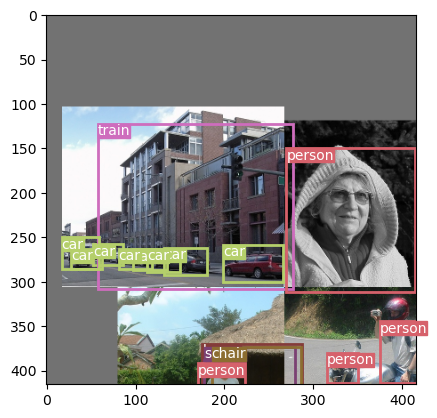

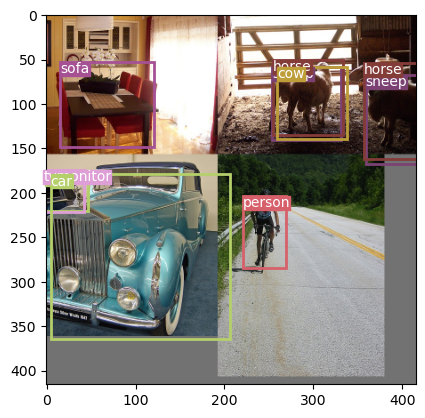

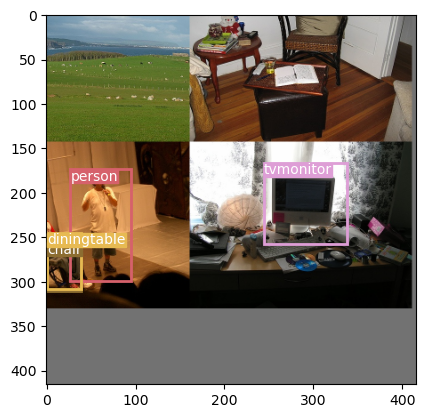

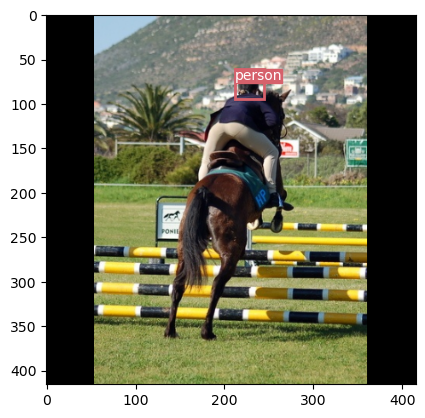

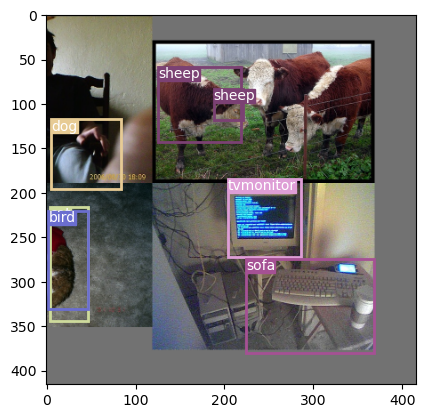

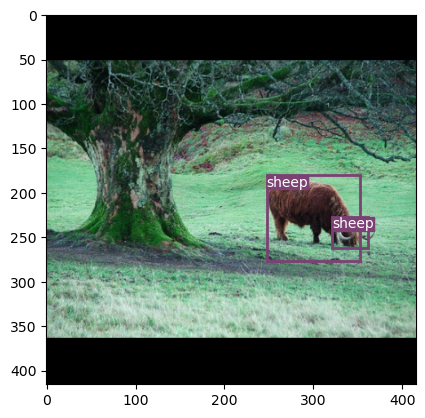

lr:  0.0004997853990630889
loss: 7.659433584876042
Currently epoch 13


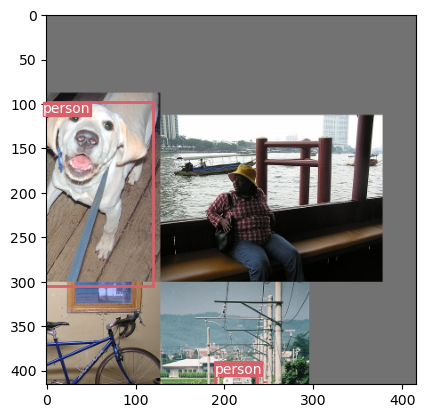

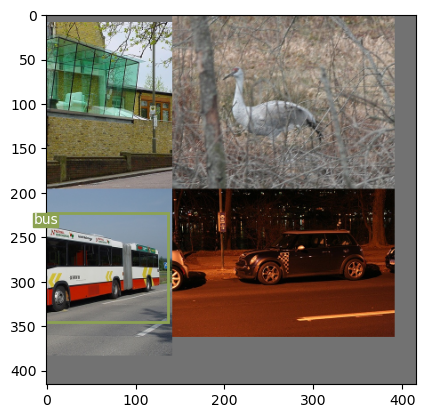

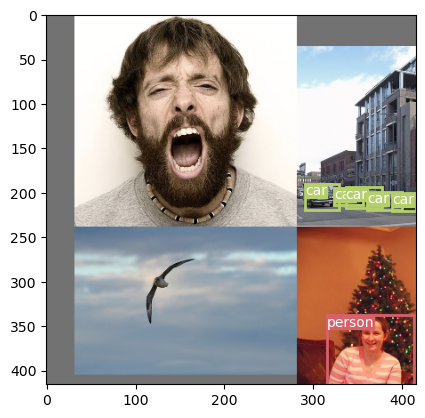

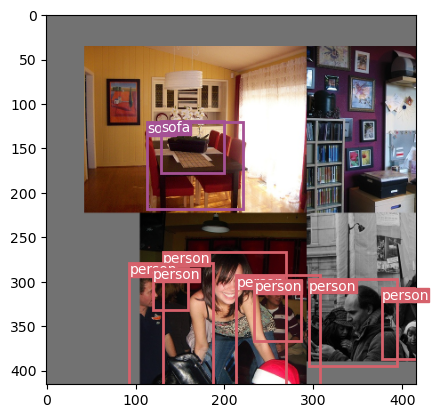

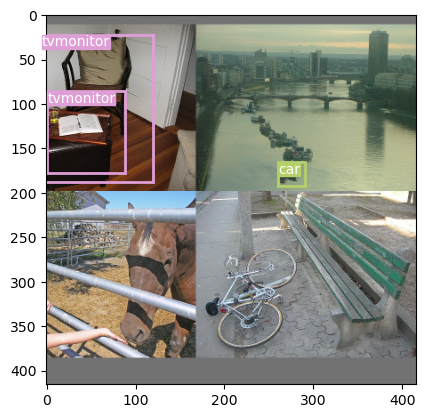

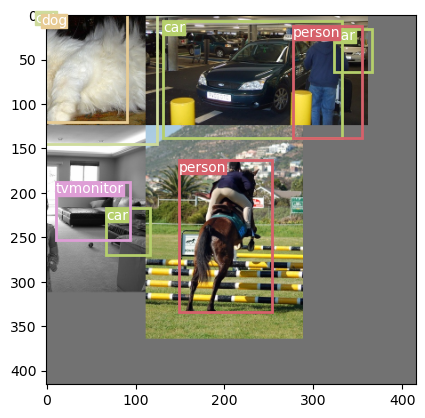

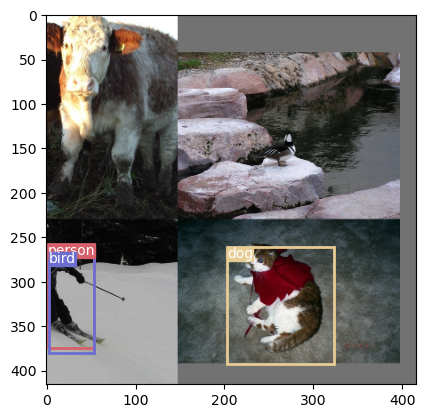

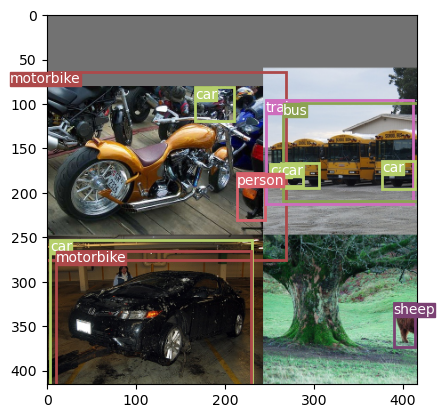

lr:  0.00038853081820433826
loss: 7.25812977805561
Currently epoch 14


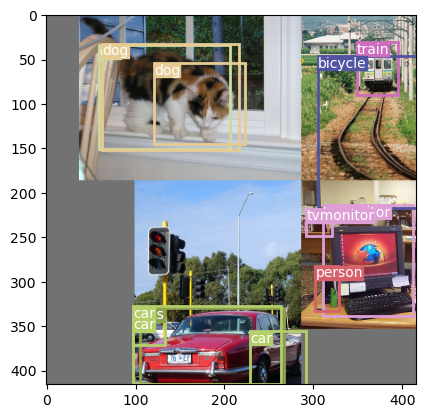

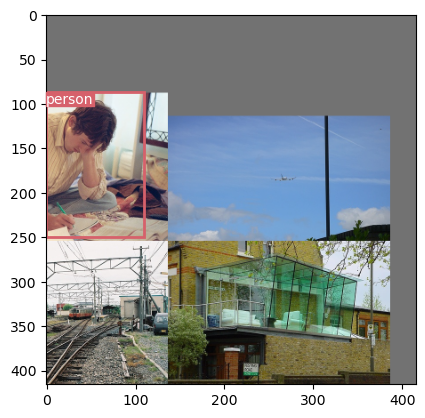

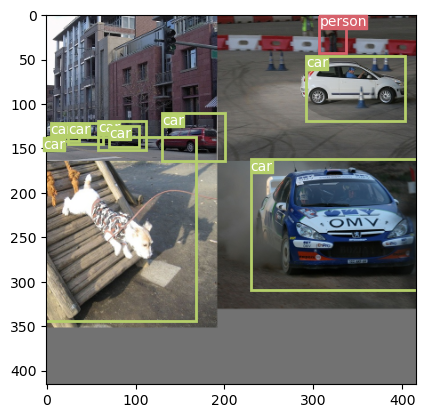

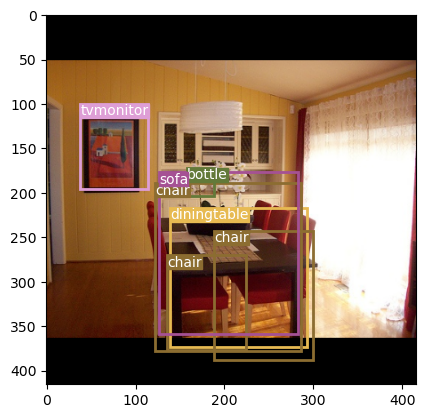

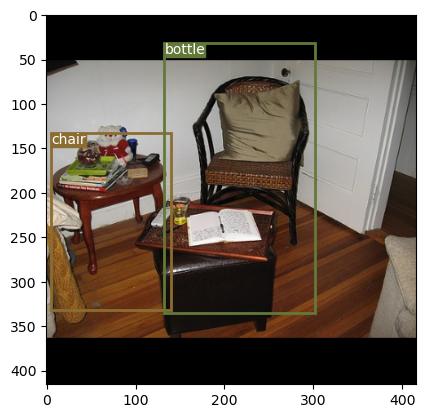

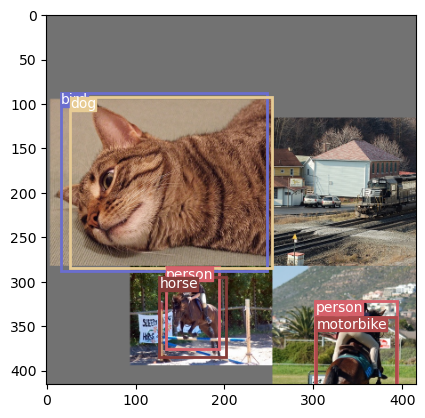

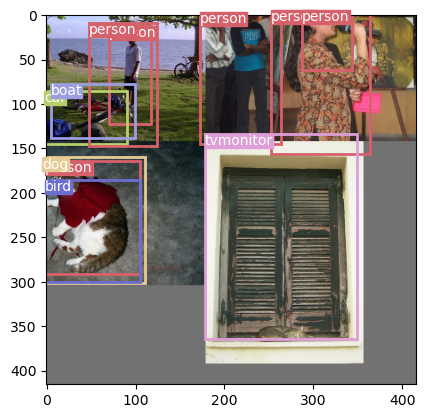

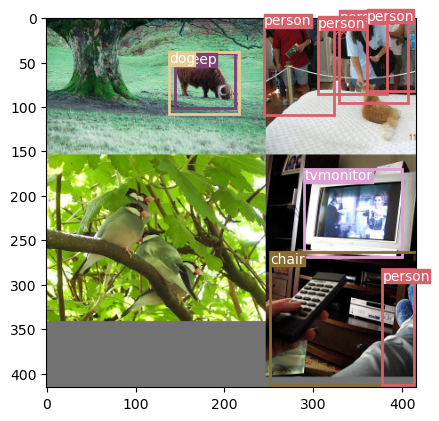

lr:  0.0002828658678639409
loss: 6.817406590840991
Currently epoch 15


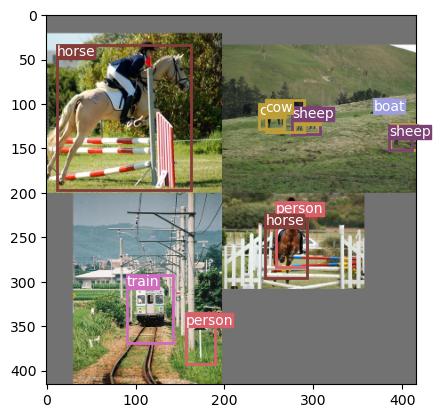

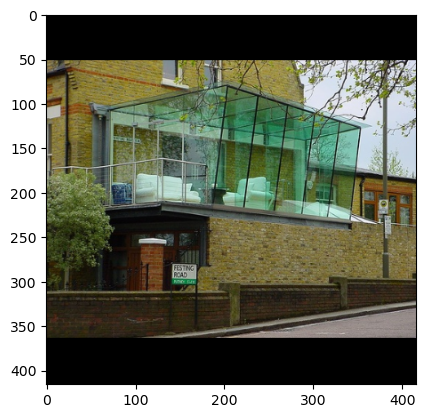

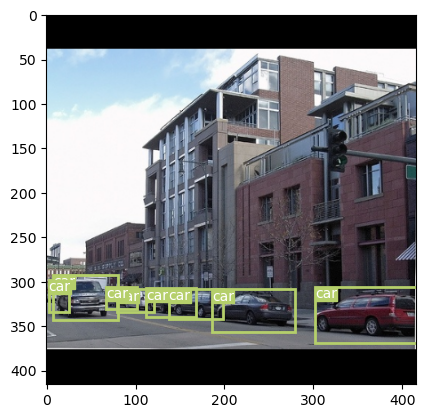

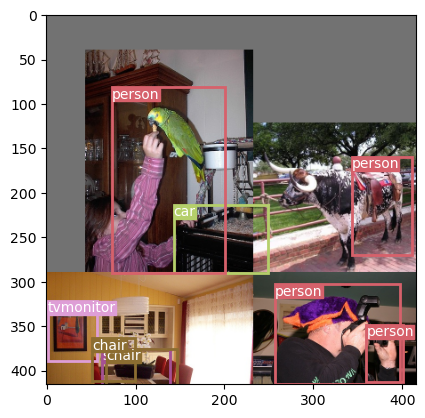

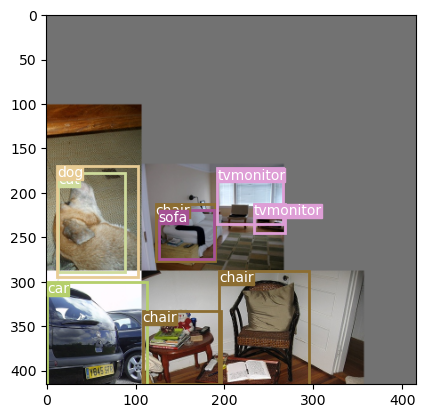

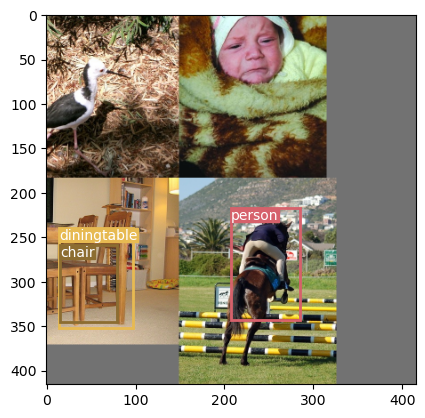

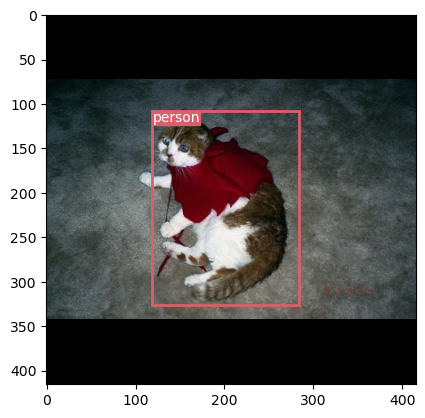

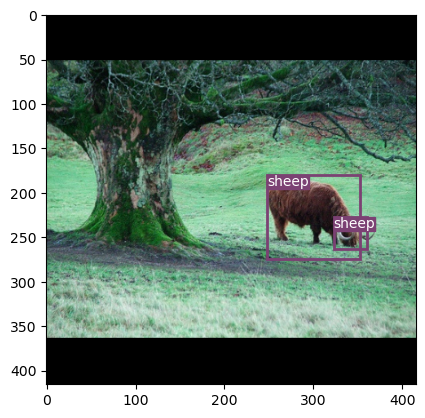

lr:  0.00018808902987037246
loss: 6.431061594642728
Currently epoch 16
On Train loader:



100%|██████████| 518/518 [08:53<00:00,  1.03s/it]


Class accuracy is: 66.265610%
No obj accuracy is: 97.742500%
Obj accuracy is: 65.597588%


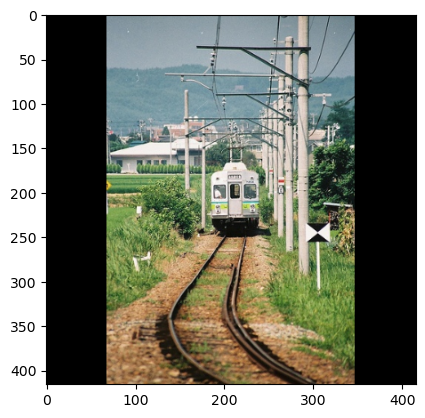

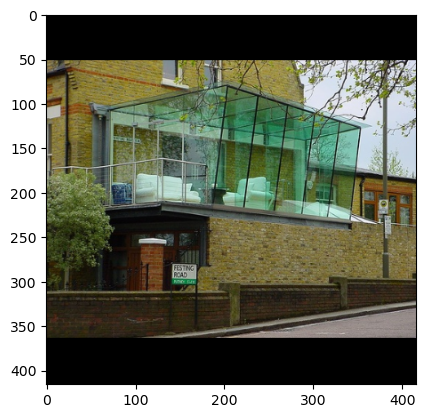

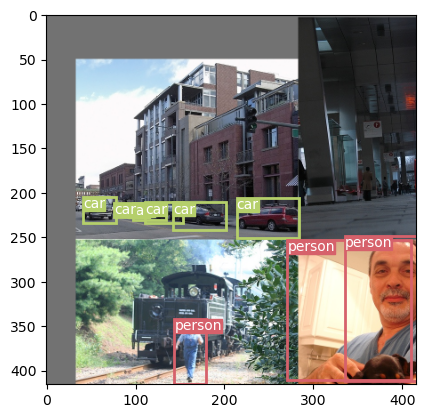

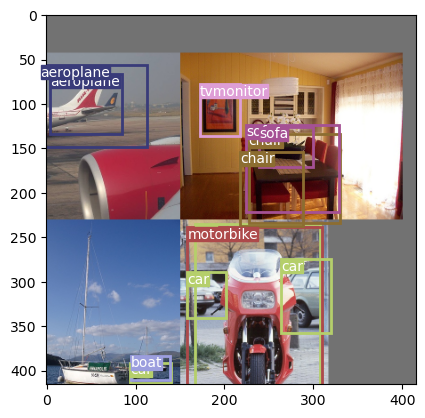

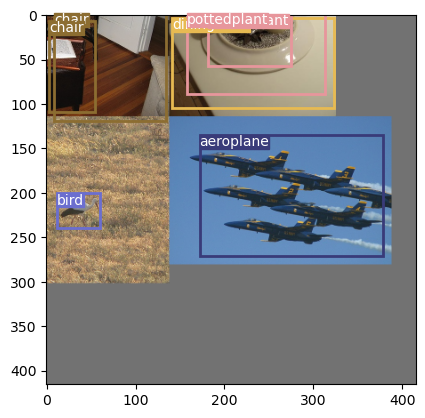

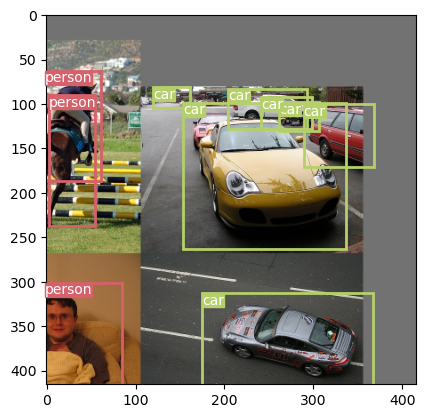

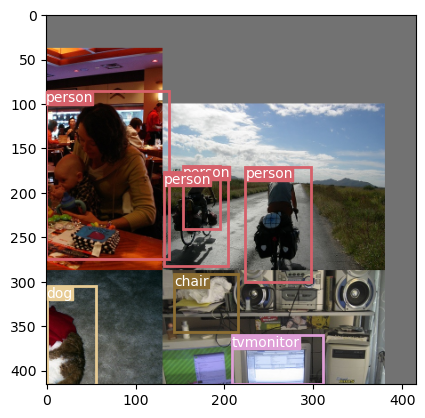

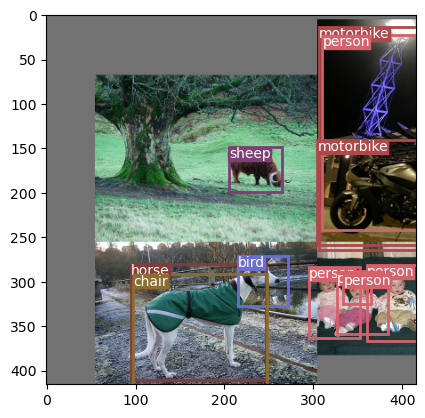

lr:  0.00010895281063424054
loss: 6.088652648520746
Currently epoch 17


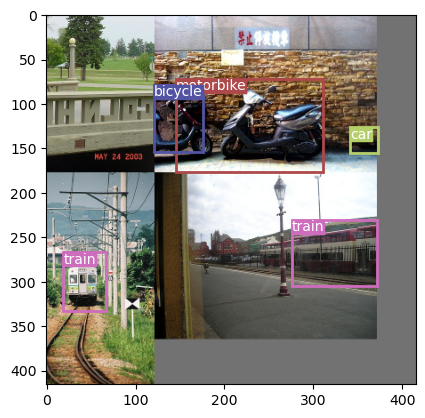

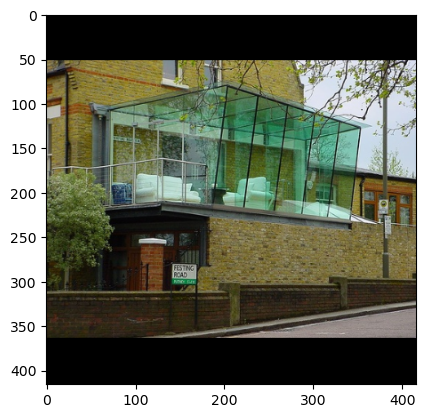

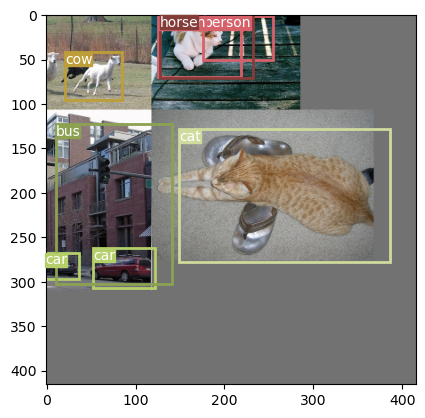

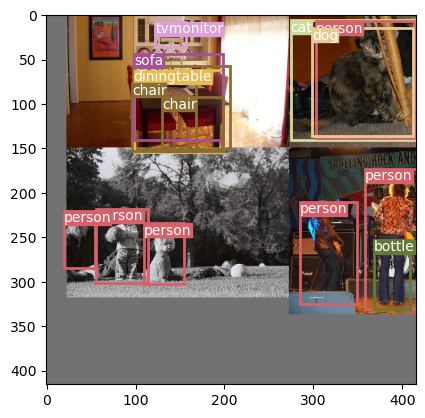

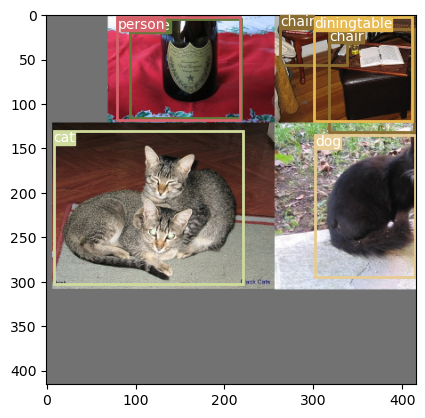

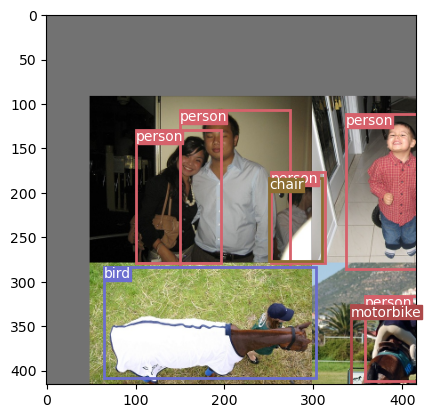

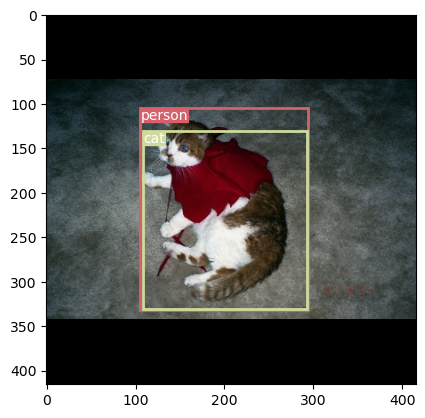

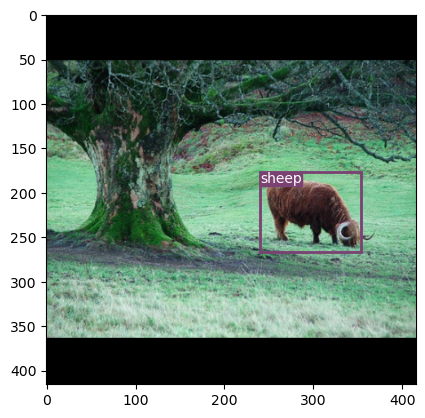

lr:  4.9425430632118616e-05
loss: 5.8382802221305585
Currently epoch 18


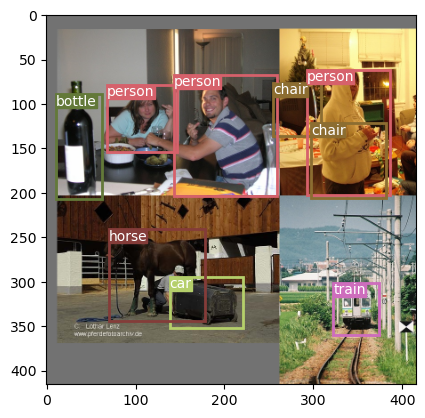

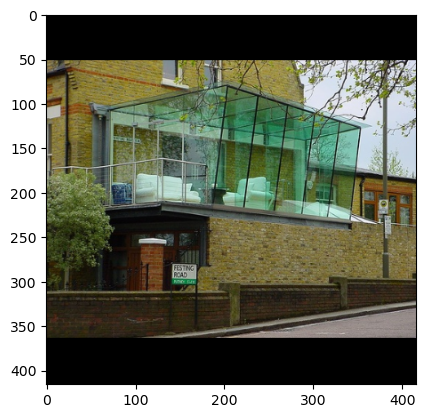

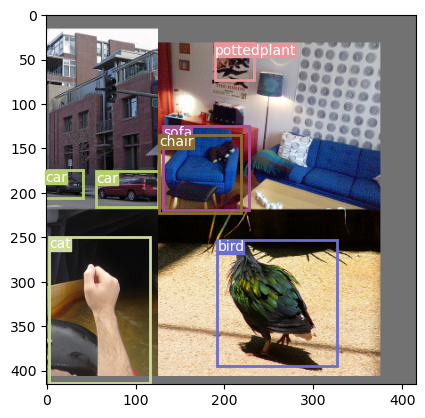

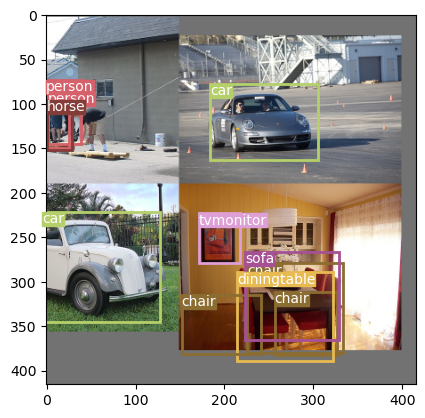

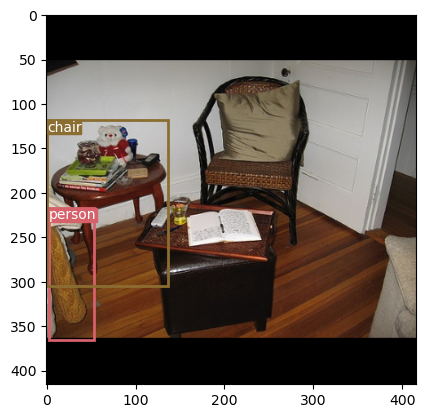

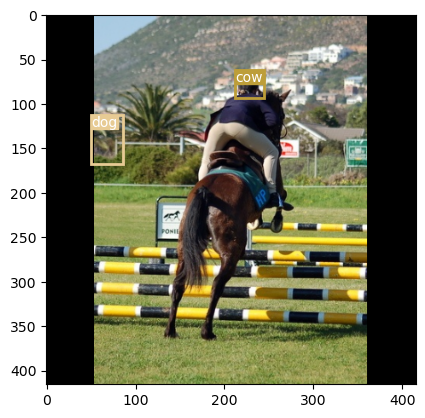

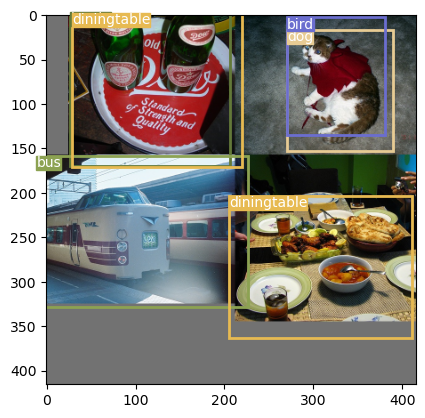

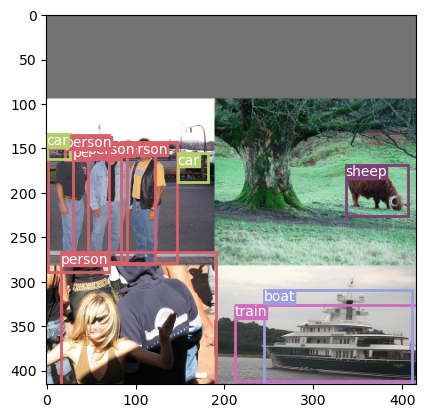

lr:  1.2491841262005058e-05
loss: 5.6354615651502575
Currently epoch 19


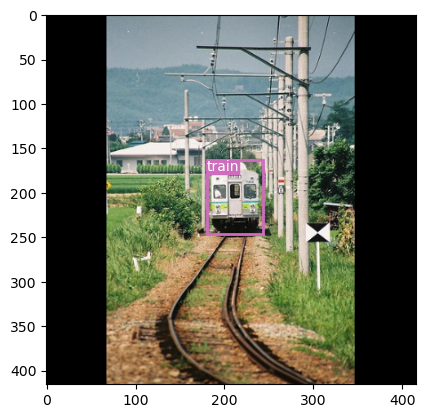

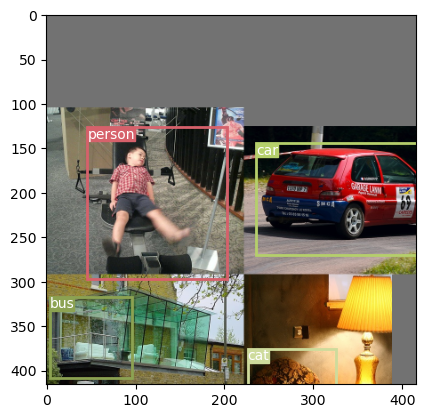

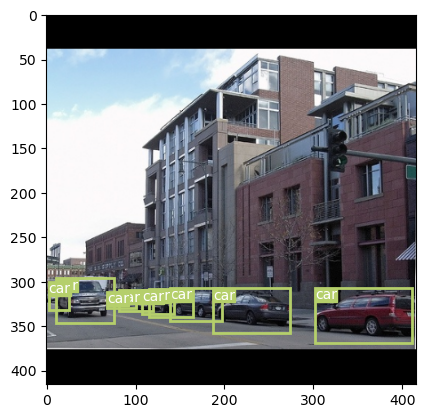

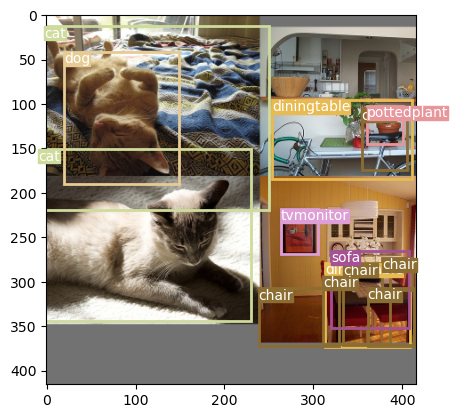

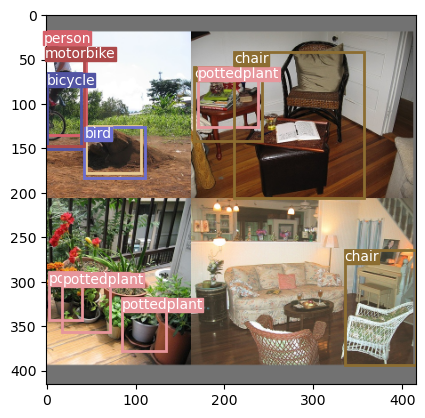

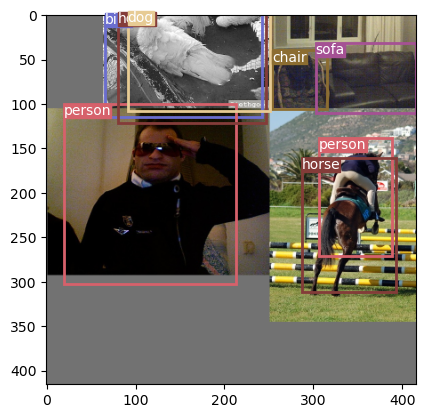

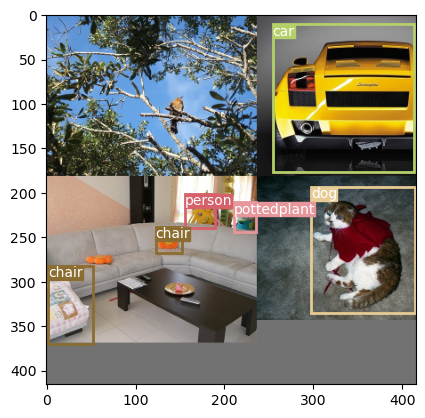

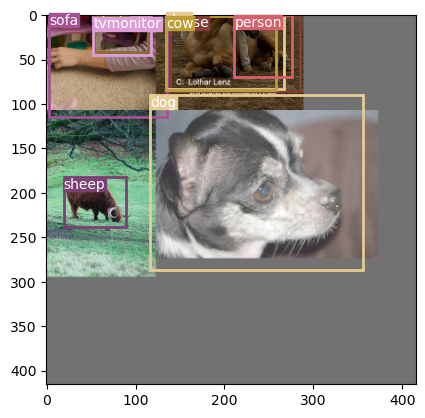

lr:  4.046916155755981e-09
loss: 5.5544408472348366
Currently epoch 20


╭─────────────────────────────── Traceback (most recent call last) ────────────────────────────────╮
│ /opt/conda/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3508 in run_code        │
│                                                                                                  │
│   3505 │   │   │   │   if async_:                                                                │
│   3506 │   │   │   │   │   await eval(code_obj, self.user_global_ns, self.user_ns)               │
│   3507 │   │   │   │   else:                                                                     │
│ ❱ 3508 │   │   │   │   │   exec(code_obj, self.user_global_ns, self.user_ns)                     │
│   3509 │   │   │   finally:                                                                      │
│   3510 │   │   │   │   # Reset our crash handler in place                                        │
│   3511 │   │   │   │   sys.excepthook = old_excepthook                                           │
│                                                                                                  │
│ in <module>:2                                                                                    │
│                                                                                                  │
│   1 # Train the model                                                                            │
│ ❱ 2 trainer.fit(yolo_model)                                                                      │
│   3                                                                                              │
│                                                                                                  │
│ /opt/conda/lib/python3.10/site-packages/pytorch_lightning/trainer/trainer.py:529 in fit          │
│                                                                                                  │
│    526 │   │   """                                                                               │
│    527 │   │   model = _maybe_unwrap_optimized(model)                                            │
│    528 │   │   self.strategy._lightning_module = model                                           │
│ ❱  529 │   │   call._call_and_handle_interrupt(                                                  │
│    530 │   │   │   self, self._fit_impl, model, train_dataloaders, val_dataloaders, datamodule,  │
│    531 │   │   )                                                                                 │
│    532                                                                                           │
│                                                                                                  │
│ /opt/conda/lib/python3.10/site-packages/pytorch_lightning/trainer/call.py:42 in                  │
│ _call_and_handle_interrupt                                                                       │
│                                                                                                  │
│    39 │   try:                                                                                   │
│    40 │   │   if trainer.strategy.launcher is not None:                                          │
│    41 │   │   │   return trainer.strategy.launcher.launch(trainer_fn, *args, trainer=trainer,    │
│ ❱  42 │   │   return trainer_fn(*args, **kwargs)                                                 │
│    43 │                                                                                          │
│    44 │   except _TunerExitException:                                                            │
│    45 │   │   _call_teardown_hook(trainer)                                                       │
│                                                                                                  │
│ /opt/conda/lib/python3.10/site-packages/pytorch_lightning/trainer/trainer.py:568 in _fit_impl    │
│                                                            

In [4]:
# Train the model
trainer.fit(yolo_model)

In [5]:
trainer.save_checkpoint("twentyepoch.ckpt")